In [83]:
import numpy as np
from fob_func import fob
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import numpy as np

In [106]:
def initialization(N, Dim, UB, LB, rng):
    """
    Inicializa a população de forma uniforme entre os limites LB e UB.
    UB e LB podem ser escalares ou arrays de tamanho Dim.
    """
    UB = np.array(UB, dtype=float)
    LB = np.array(LB, dtype=float)
    
    if UB.size == 1:  # limites iguais para todas as variáveis
        X = rng.random((N, Dim)) * (UB - LB) + LB
    else:  # limites diferentes por variável
        X = np.zeros((N, Dim))
        for i in range(Dim):
            X[:, i] = rng.random(N) * (UB[i] - LB[i]) + LB[i]
    return X


def AOA(N, M_Iter, LB, UB, Dim, F_obj, rng):
    print("AOA Working")
    
    Best_P = np.zeros(Dim)
    Best_FF = np.inf
    Conv_curve = np.zeros(M_Iter)
    
    # Inicializa posições
    X = initialization(N, Dim, UB, LB, rng)
    Xnew = np.copy(X)
    
    Ffun = np.zeros(N)
    Ffun_new = np.zeros(N)
    
    MOP_Max = 1
    MOP_Min = 0.2
    Alpha = 5
    Mu = 0.499
    
    # Avaliação inicial
    for i in range(N):
        Ffun[i] = F_obj(X[i, :])
        if Ffun[i] < Best_FF:
            Best_FF = Ffun[i]
            Best_P = np.copy(X[i, :])
    
    C_Iter = 1
    while C_Iter <= M_Iter:
        MOP = 1 - ((C_Iter)**(1/Alpha) / (M_Iter)**(1/Alpha))
        MOA = MOP_Min + C_Iter * ((MOP_Max - MOP_Min) / M_Iter)
        
        for i in range(N):
            for j in range(Dim):
                r1 = rng.random()
                
                if np.size(LB) == 1:  # limites iguais
                    if r1 < MOA:
                        r2 = rng.random()
                        if r2 > 0.5:
                            Xnew[i, j] = Best_P[j] / (MOP + np.finfo(float).eps) * ((UB - LB) * Mu + LB)
                        else:
                            Xnew[i, j] = Best_P[j] * MOP * ((UB - LB) * Mu + LB)
                    else:
                        r3 = rng.random()
                        if r3 > 0.5:
                            Xnew[i, j] = Best_P[j] - MOP * ((UB - LB) * Mu + LB)
                        else:
                            Xnew[i, j] = Best_P[j] + MOP * ((UB - LB) * Mu + LB)
                
                else:  # limites diferentes por variável
                    if r1 < MOA:
                        r2 = rng.random()
                        if r2 > 0.5:
                            Xnew[i, j] = Best_P[j] / (MOP + np.finfo(float).eps) * ((UB[j] - LB[j]) * Mu + LB[j])
                        else:
                            Xnew[i, j] = Best_P[j] * MOP * ((UB[j] - LB[j]) * Mu + LB[j])
                    else:
                        r3 = rng.random()
                        if r3 > 0.5:
                            Xnew[i, j] = Best_P[j] - MOP * ((UB[j] - LB[j]) * Mu + LB[j])
                        else:
                            Xnew[i, j] = Best_P[j] + MOP * ((UB[j] - LB[j]) * Mu + LB[j])
            
            # Correção de limites
            if np.size(LB) == 1:
                Xnew[i, :] = np.clip(Xnew[i, :], LB, UB)
            else:
                Xnew[i, :] = np.minimum(np.maximum(Xnew[i, :], LB), UB)
            
            # Avaliação
            Ffun_new[i] = F_obj(Xnew[i, :])
            if Ffun_new[i] < Ffun[i]:
                X[i, :] = Xnew[i, :]
                Ffun[i] = Ffun_new[i]
            if Ffun[i] < Best_FF:
                Best_FF = Ffun[i]
                Best_P = np.copy(X[i, :])
        
        Conv_curve[C_Iter-1] = Best_FF
        
        if C_Iter % 5 == 0:
            print(f"At iteration {C_Iter} the best solution fitness is {Best_FF}")
        
        C_Iter += 1
    
    return Best_FF, Best_P, Conv_curve


In [110]:
# Define um wrapper inline para converter numpy array para list e chamar fob
def fitness_wrapper(x):
    return fob(x.tolist())

x = np.array([1, 1])
print(fitness_wrapper(x))

836.2828580303842


In [222]:
# Teste
def sphere(x):
    return np.sum(x**2)

N = 30
M_Iter = 100
LB = -500
UB = 500
Dim = 2
seed = None
rng = np.random.default_rng(seed)

best_fit, best_pos, conv = AOA(N, M_Iter, LB, UB, Dim, fitness_wrapper, rng)
print("Best fitness:", best_fit)
print("Best position:", best_pos)


AOA Working
At iteration 5 the best solution fitness is 348.93395907318086
At iteration 10 the best solution fitness is 335.59229770169986
At iteration 15 the best solution fitness is 335.5899254310581
At iteration 20 the best solution fitness is 335.58747855997296
At iteration 25 the best solution fitness is 335.5851765390612
At iteration 30 the best solution fitness is 335.58377191686475
At iteration 35 the best solution fitness is 335.5823827298226
At iteration 40 the best solution fitness is 335.58137404364925
At iteration 45 the best solution fitness is 335.58068128587865
At iteration 50 the best solution fitness is 335.580073188923
At iteration 55 the best solution fitness is 335.5796256375489
At iteration 60 the best solution fitness is 335.5791583422806
At iteration 65 the best solution fitness is 335.5788307727181
At iteration 70 the best solution fitness is 335.578646354753
At iteration 75 the best solution fitness is 335.57847811583264
At iteration 80 the best solution fitne

In [100]:
# Grid search - criar malha de pontos
x1 = np.linspace(-1000, 1000, 1000)  # 100 pontos de -5 a 5
x2 = np.linspace(-1000, 1000, 1000)  
X1, X2 = np.meshgrid(x1, x2)

# Avaliar fob para cada ponto do grid
Z = np.zeros_like(X1)
for i in range(X1.shape[0]):
    for j in range(X1.shape[1]):
        Z[i, j] = fob([X1[i, j], X2[i, j]])


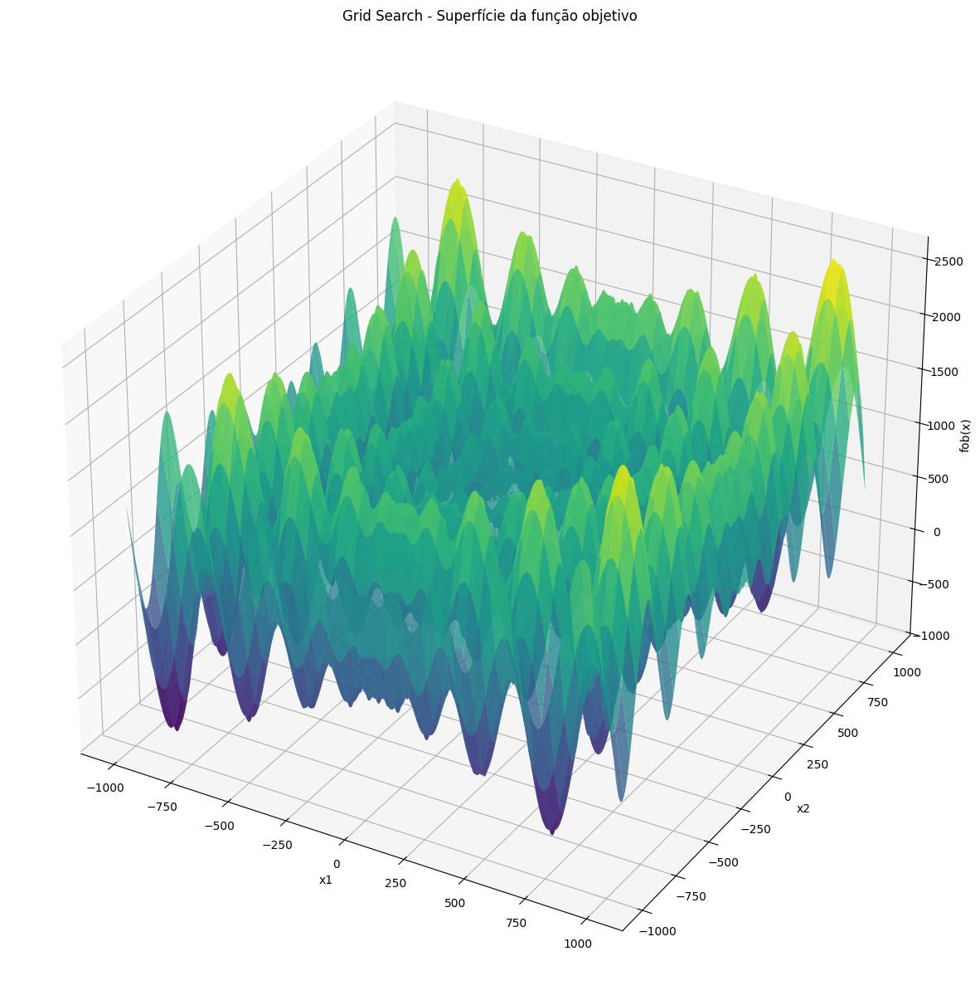

In [101]:
# Avaliar fob para cada ponto do grid
Z = np.zeros_like(X1)
for i in range(X1.shape[0]):
    for j in range(X1.shape[1]):
        Z[i, j] = fob([X1[i, j], X2[i, j]])

# Plot 3D
fig = plt.figure(figsize=(15, 28))
ax = fig.add_subplot(111, projection='3d')

ax.plot_surface(X1, X2, Z, cmap='viridis', edgecolor='none', alpha=0.8)
ax.set_xlabel('x1')
ax.set_ylabel('x2')
ax.set_zlabel('fob(x)')
ax.set_title('Grid Search - Superfície da função objetivo')

plt.show()

In [102]:
# Supondo que você já tenha X1, X2, Z (matrizes numpy do grid e valores da função)

fig = go.Figure(data=[go.Surface(z=Z, x=X1, y=X2, colorscale='Viridis')])

fig.update_layout(title='Função objetivo fob 3D interativa',
                     width=1600,   # largura em pixels
                     height=1200,  # altura em pixels
                     scene=dict(
                     xaxis_title='x1',
                     yaxis_title='x2',
                     zaxis_title='fob(x)'
                  ))

fig.show()

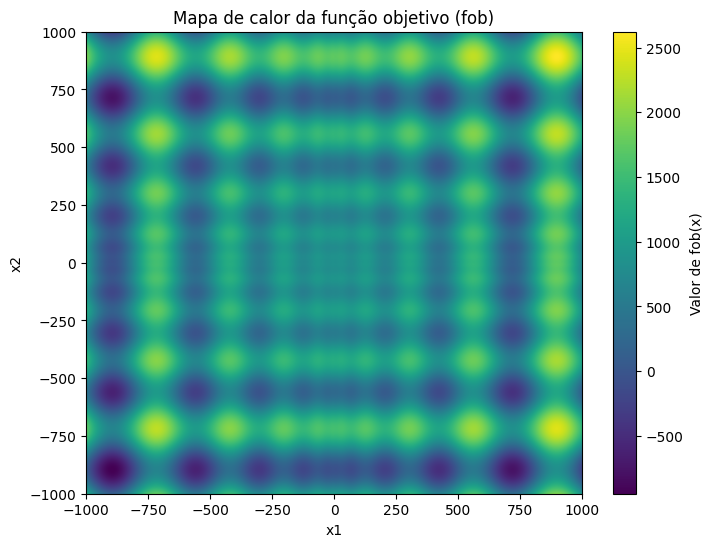

In [103]:
plt.figure(figsize=(8,6))
# Mostrar Z como imagem, com interpolação 'nearest' e mapa de cores 'viridis'
plt.imshow(Z, extent=[x1.min(), x1.max(), x2.min(), x2.max()], origin='lower', cmap='viridis', aspect='auto')

plt.colorbar(label='Valor de fob(x)')
plt.xlabel('x1')
plt.ylabel('x2')
plt.title('Mapa de calor da função objetivo (fob)')

plt.show()

In [104]:
# 1. Índice do menor valor na matriz Z
min_index = np.argmin(Z)

# 2. Converter índice linear para índice 2D (linha, coluna)
min_pos = np.unravel_index(min_index, Z.shape)

# 3. Obter x e y correspondentes
x_min = X1[min_pos]
y_min = X2[min_pos]
fob_min = Z[min_pos]

print(f"Menor valor de fob: {fob_min}")
print(f"Coordenadas que minimizam fob: x = {x_min}, y = {y_min}")

Menor valor de fob: -947.3184273514139
Coordenadas que minimizam fob: x = -893.8938938938938, y = -893.8938938938938


In [105]:
print(fob([-893.8938938938938, -893.8938938938938]))

-947.3184273514139
